In [125]:
import cv2
from matplotlib import pyplot as plt

In [126]:
from glob import glob
pics = glob('tests/data/*')
pics

['tests/data/1.jpeg',
 'tests/data/7.jpeg',
 'tests/data/8.jpeg',
 'tests/data/4.jpeg',
 'tests/data/5.jpeg',
 'tests/data/2.jpeg',
 'tests/data/6.png',
 'tests/data/1.png',
 'tests/data/3.jpeg']

<ipython-input-117-fd3d782a900b>:42: RuntimeWarning: divide by zero encountered in int_scalars
  return (self.end.y-self.start.y)/(self.end.x-self.start.x)


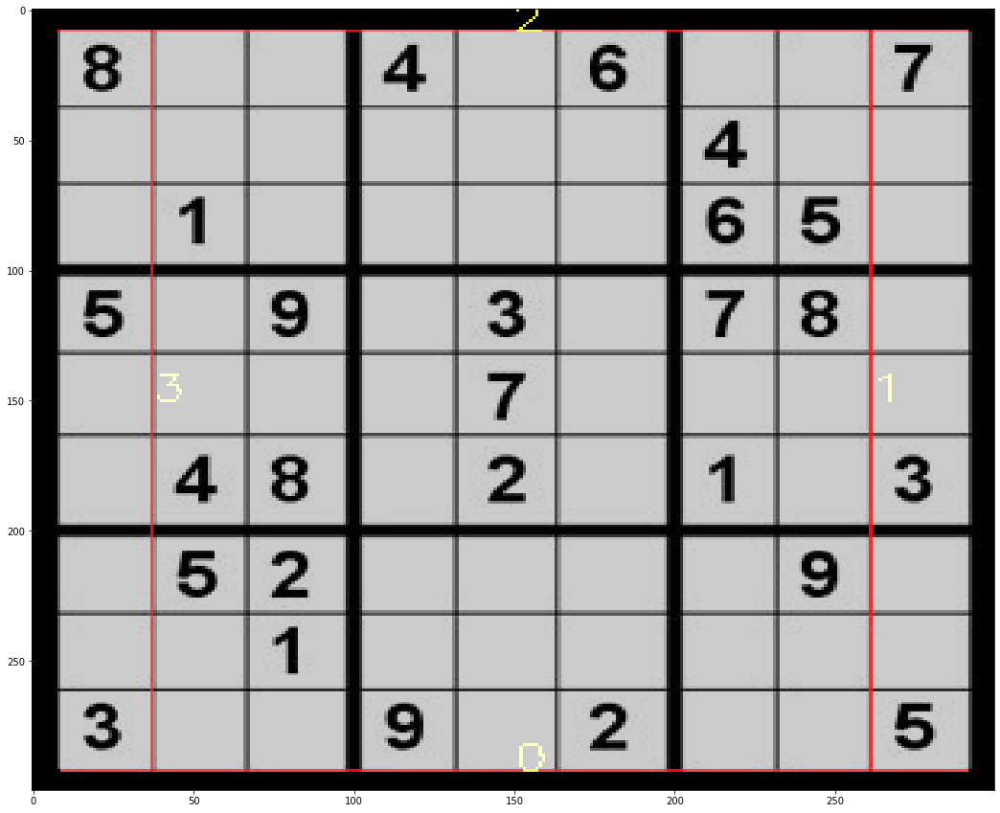

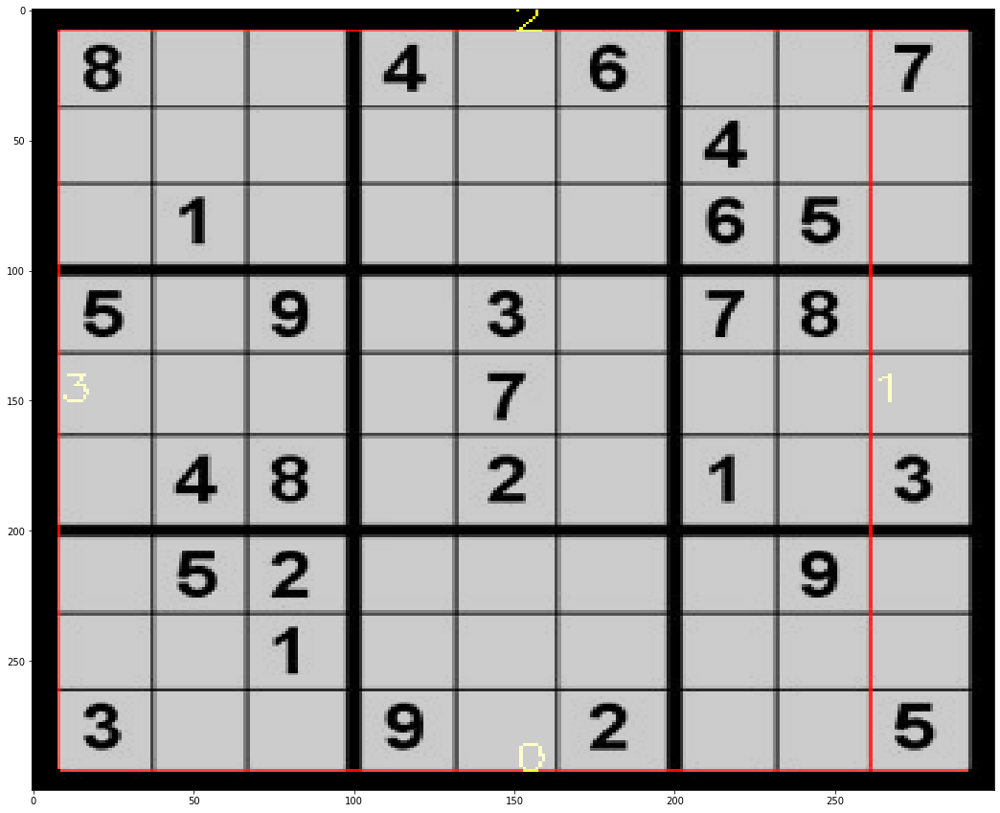

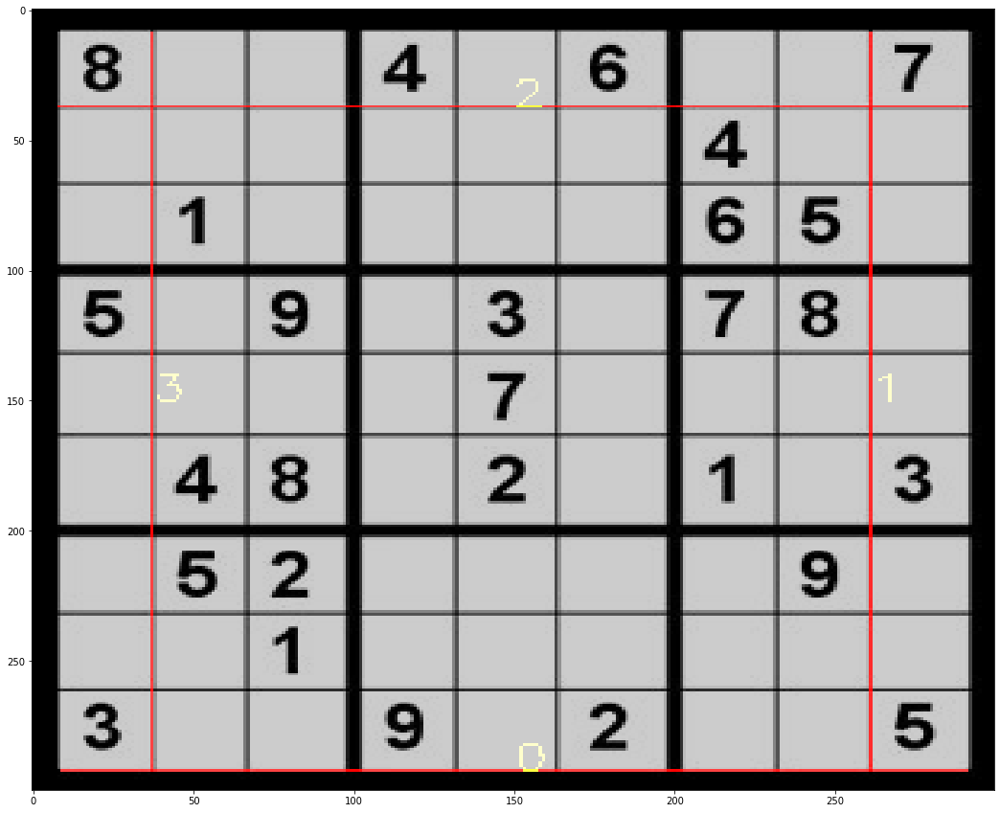

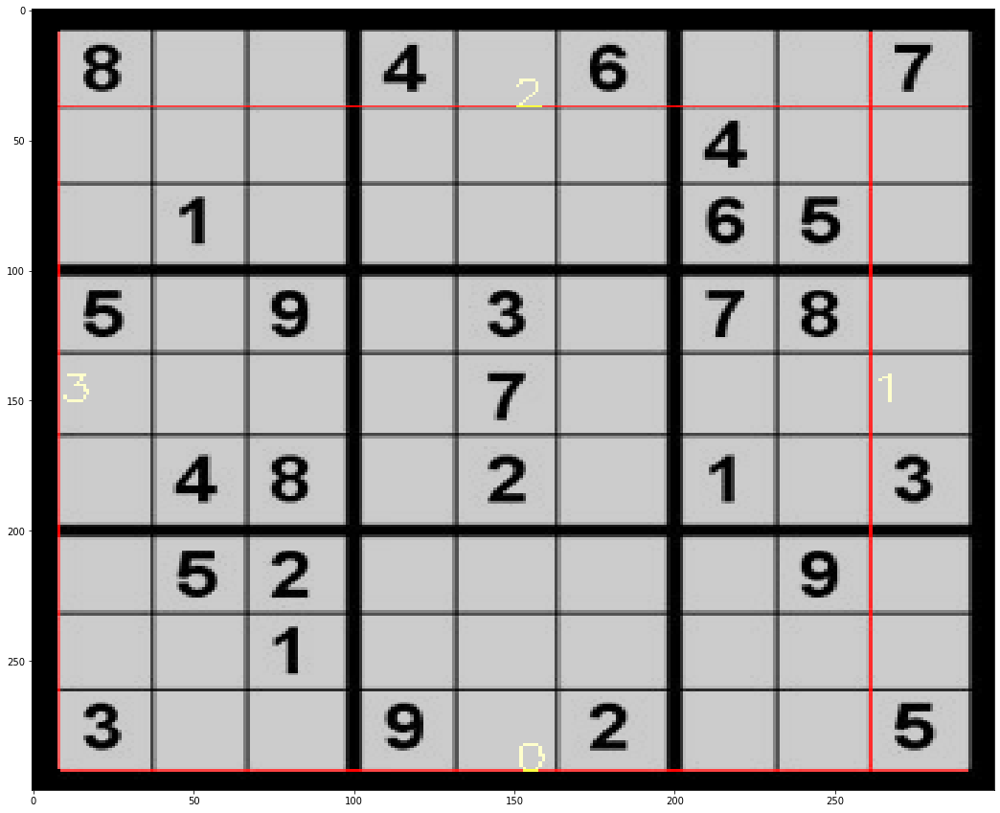

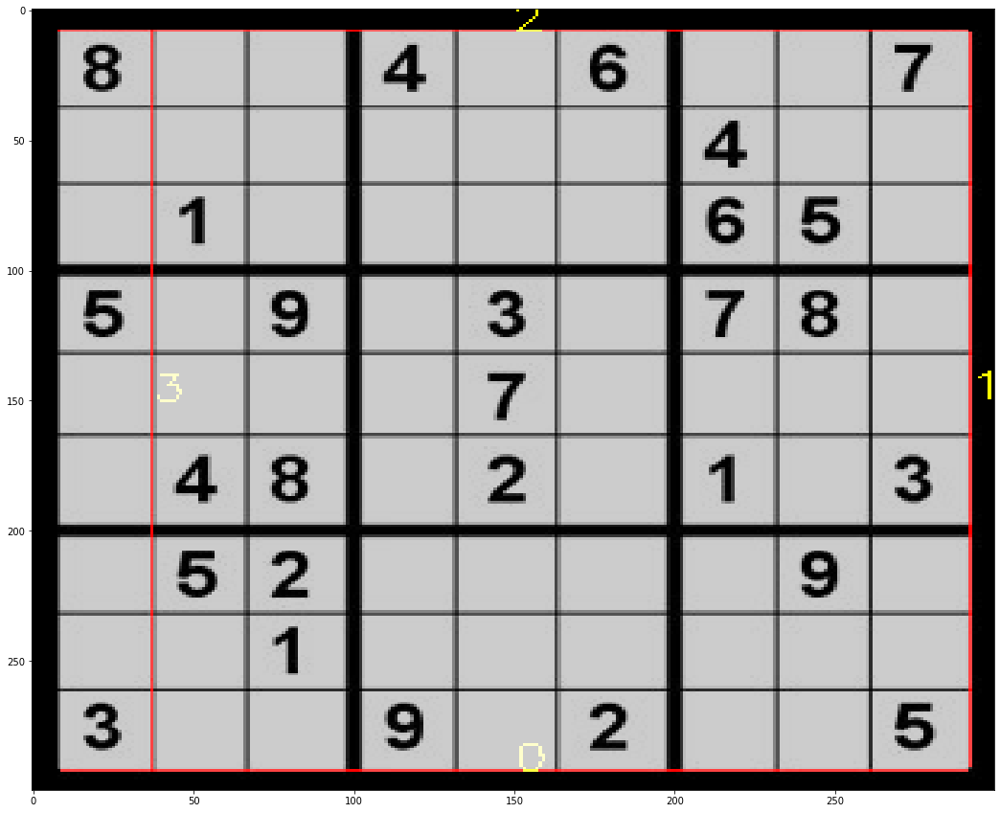

...

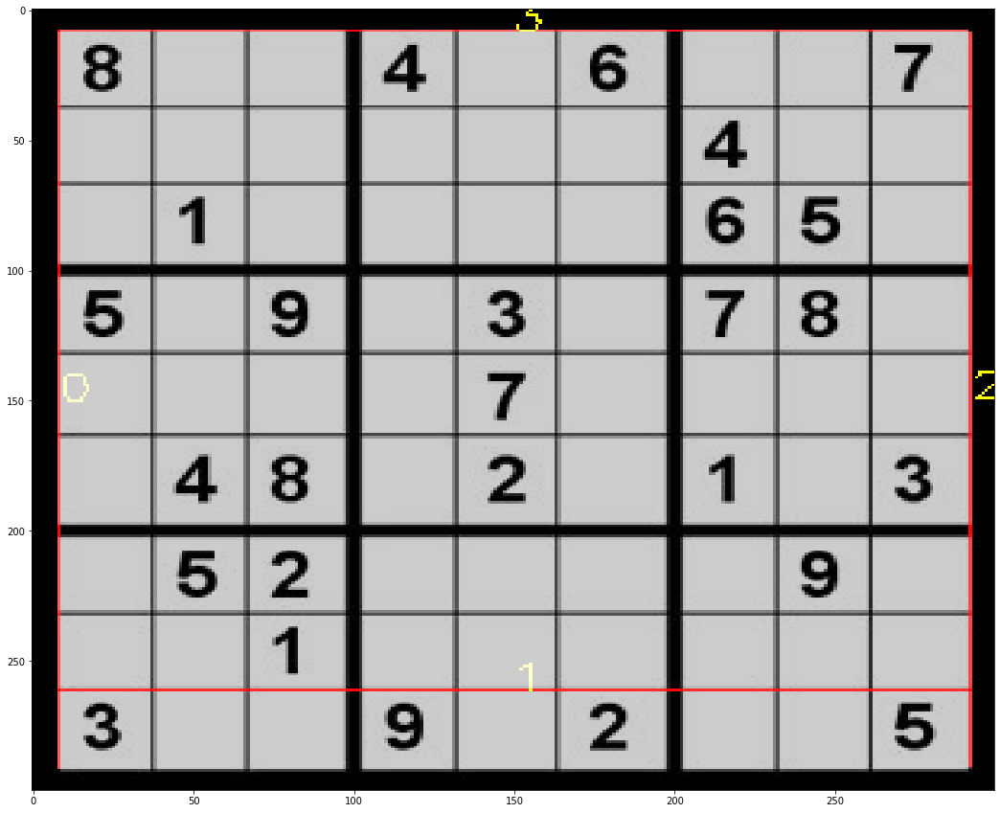

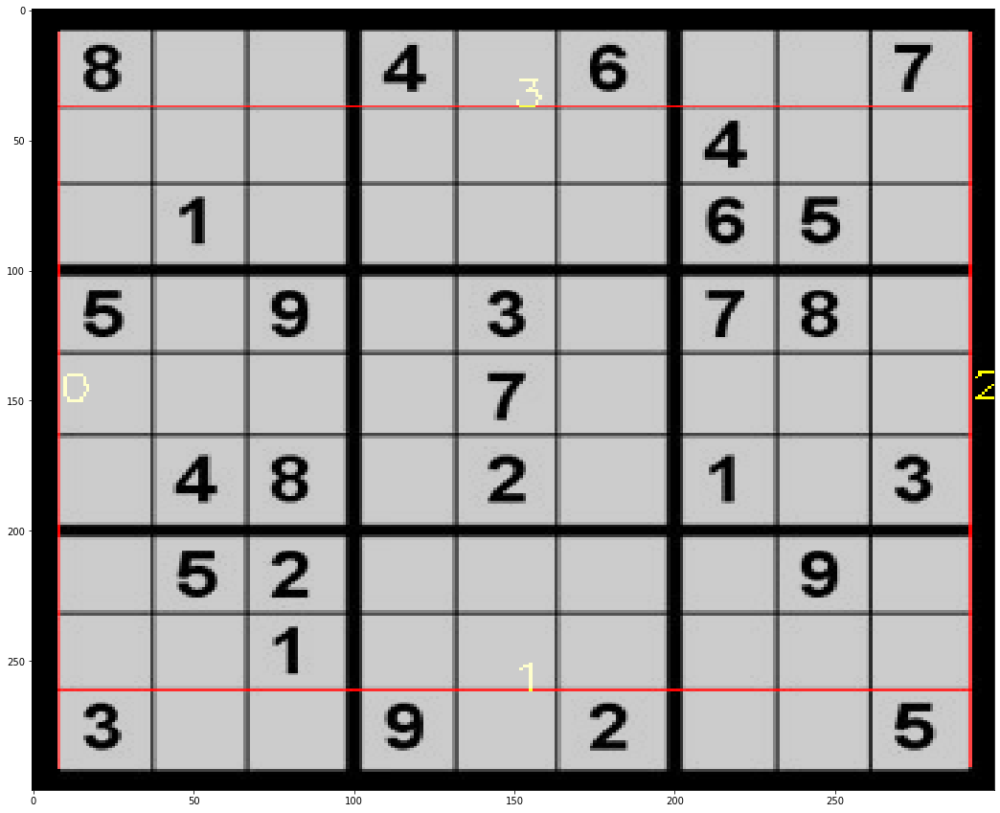

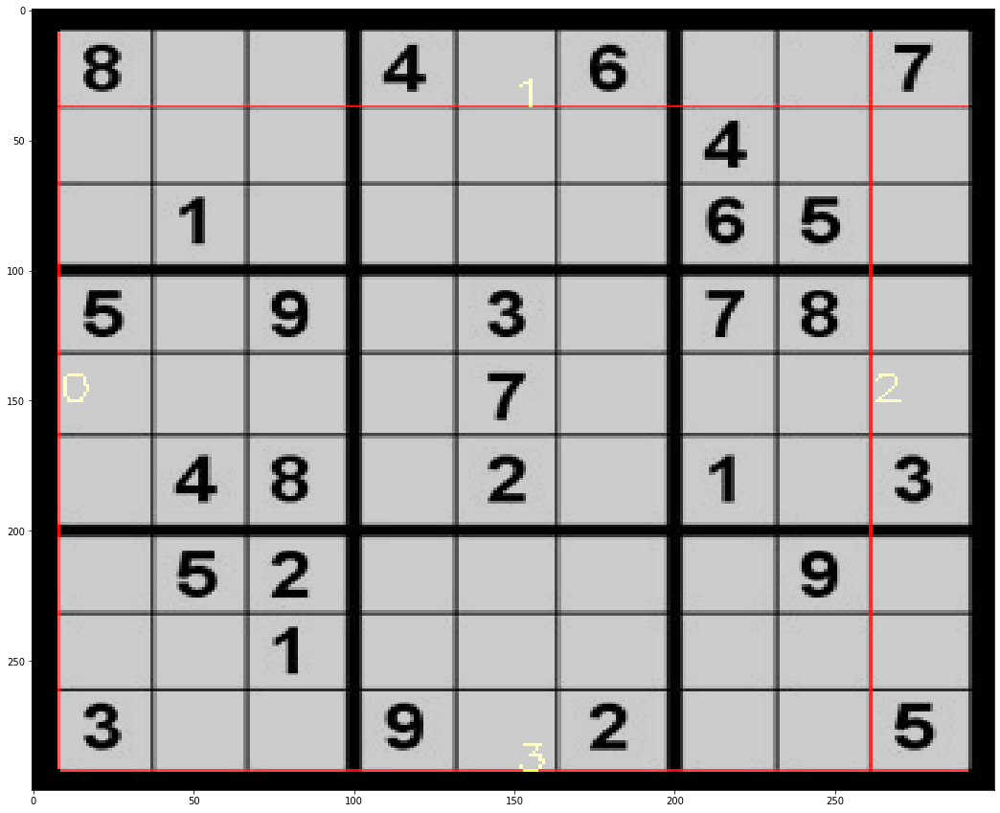

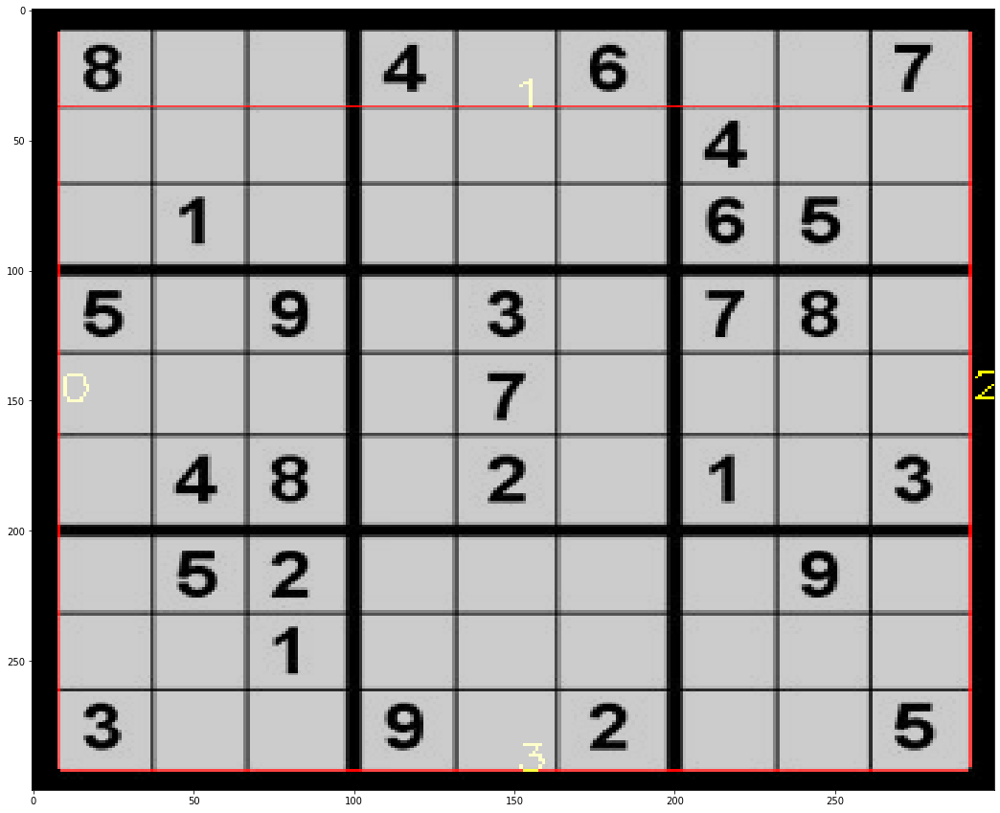

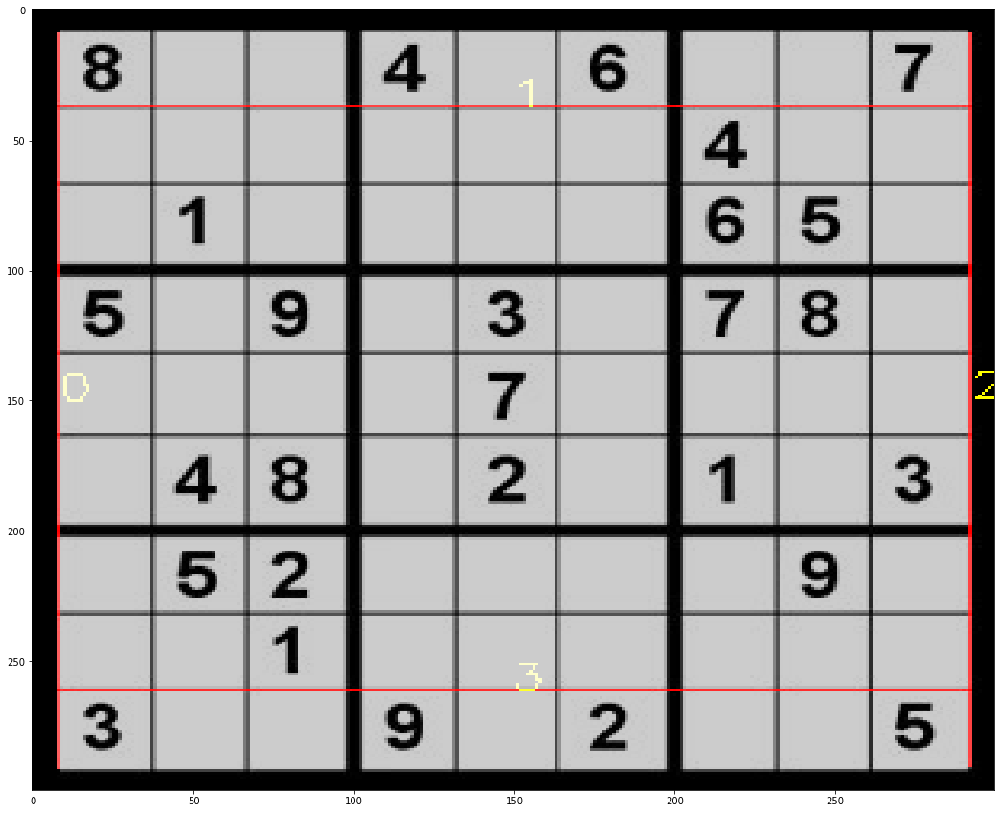

TypeError: 'NoneType' object is not iterable

In [127]:
for i, pic in enumerate(pics):
    img = cv2.imread(pic)
#     plt.imshow(img)
#     plt.show()
    preprcess_pipeline(img)


In [117]:
# 20 линии, которые формируют квадрат в диапазоне н пикселей
# dynamic programming
import math
from dataclasses import dataclass
from collections import namedtuple
from math import pi

@dataclass
class Point:
    x: int
    y: int
        
    def dist_to(self, point):
        return np.linalg.norm([self.x-point.x, self.y-point.y])


@dataclass
class Line:
    start: Point
    end: Point
        
    def __init__(self, *args, **kwargs):
        if all([type(arg) == Point for arg in args]) and len(args) == 2:
            self.start = args[0]
            self.end = args[1]    
        elif 'start' in kwargs and 'end' in kwargs:
            self.start = kwargs['start']
            self.end = kwargs['end']
        
        elif len(args)==1 and len(args[0]) == 4:
            self.start = Point(*args[0][:2])
            self.end = Point(*args[0][2:])
        else:
            raise Exception('чо то на непонятном!')
    
    @property
    def length(self):
        return np.linalg.norm([self.start.x-self.end.x, self.start.y-self.end.y])
    
    @property
    def tan(self):
        return (self.end.y-self.start.y)/(self.end.x-self.start.x)
    
    @property
    def angle(self):
        return np.arctan(self.tan)
    
    @property
    def b(self):
        return self.start.y - self.tan * self.start.x
    
    def close_enought(self, point, avg_len):
        return min(self.start.dist_to(point), self.end.dist_to(point))/avg_len < 0.15
    
    def avg_length(self, line):
        return (self.length + line.length)/2
    
    def connected(self, line):
        avg_len = self.avg_length(line)
        if self.close_enought(line.start, avg_len):
            return True
        if self.close_enought(line.end, avg_len):
            return True
        return False
    
    def connected_to(self, line):
        avg_len = self.avg_length(line)
        if line.close_enought(self.start, avg_len):
            return self.start
        if line.close_enought(self.end, avg_len):
            return self.end
        return None
    
    def not_connected_to(self, line):
        avg_len = self.avg_length(line)
        if self.close_enought(line.start, avg_len):
            return self.end
        if self.close_enought(line.end, avg_len):
            return self.start
        return None


@dataclass
class BoundingBox:
    left: Line
    right: Line
    bottom: Line
    top: Line


@dataclass
class PairOfLines:
    left_top: Line
    right_bottom: Line
        

@dataclass
class Grid:
    box: BoundingBox

    left: PairOfLines
    ver_mid: PairOfLines
    right: PairOfLines
        
    top: PairOfLines
    hor_mid: PairOfLines
    bottom: PairOfLines


def same_line(line1, line2, verbose=False):
    threshold_edges = 0.3
    threshold_dist = 0.02
    threshold_angle = 0.01

    if verbose:
        print('angles', line1.angle, line2.angle)

    avg_len = line1.avg_length(line2)
    
    if abs(line1.angle - line2.angle) < threshold_angle:        
        if verbose:
            print('bs', line1.b, line2.b)
            
        if line1.b == np.inf or line2.b == np.inf:
            distance = abs(line1.start.x-line2.start.x)
        else:
            distance = abs(line2.b-line1.b)/math.sqrt(line1.tan**2+1)
        if verbose:
            print('dist avg len', distance/avg_len)
        if distance/avg_len < threshold_dist:
            return True
    return False

def average_of_2_lines(line1, line2):
    if line1.start.dist_to(line2.start) < line1.start.dist_to(line2.end):
        return Line([
            (line1.start.x + line2.start.x) // 2,
            (line1.start.y + line2.start.y) // 2,
            (line1.end.x + line2.end.x) // 2,
            (line1.end.y + line2.end.y) // 2,
        ])
    return Line([
            (line1.start.x + line2.end.x) // 2,
            (line1.start.y + line2.end.y) // 2,
            (line1.end.x + line2.start.x) // 2,
            (line1.end.y + line2.start.y) // 2,
        ])


def is_loop(lines):
    if len(lines) < 3:
        raise Exceptionn
    if is_chain(lines) and lines[0].connected(lines[-1]) and lines[-1].connected_to(lines[0]) != lines[-1].connected_to(lines[-2]):
        return True
    return False

def is_chain(lines, start=None):
    if len(lines) == 2 and lines[0].connected(lines[1]):
        return True
    if lines[0].connected(lines[1]) and lines[1].connected_to(lines[0]) != lines[1].connected_to(lines[2]):
        return is_chain(lines[1:])
    return False
            
point1 = Point(20, 100)
point1_ = Point(22, 95)

point2 = Point(34, 303)
point2_ = Point(30, 300)

point3 = Point(323, 56)
point3_ = Point(320, 54)

point4 = Point(305, 325)
point4_ = Point(322, 351)

# point1 = Point(x=419, y=409)
# point1_ = Point(x=399, y=404)
# point2 = Point(x=121, y=325)
# point2_ = Point(x=109, y=320)
# point3 = Point(x=180, y=425)
# point3_ = Point(x=127, y=325)
# point4 = Point(x=420, y=409)
# point4_ = Point(x=483, y=134)

# line1 = Line(Point(x=419, y=409), Point(x=483, y=134))
# line2 = Line(start=Point(x=121, y=325), end=Point(x=399, y=404))
# line3 = Line(start=Point(x=109, y=320), end=Point(x=180, y=425))
# line4 = Line(start=Point(x=127, y=325), end=Point(x=420, y=409))

line1 = Line(point1_, point2)
line2 = Line(point2_, point3)
line3 = Line(point3_, point4)
line4 = Line(point4_, point1)

loop = [line1, line2, line3, line4]
not_loop = [line2, line1, line3, line4]

is_chain(loop), is_chain(not_loop)
is_loop(loop), is_loop(not_loop)

(True, False)

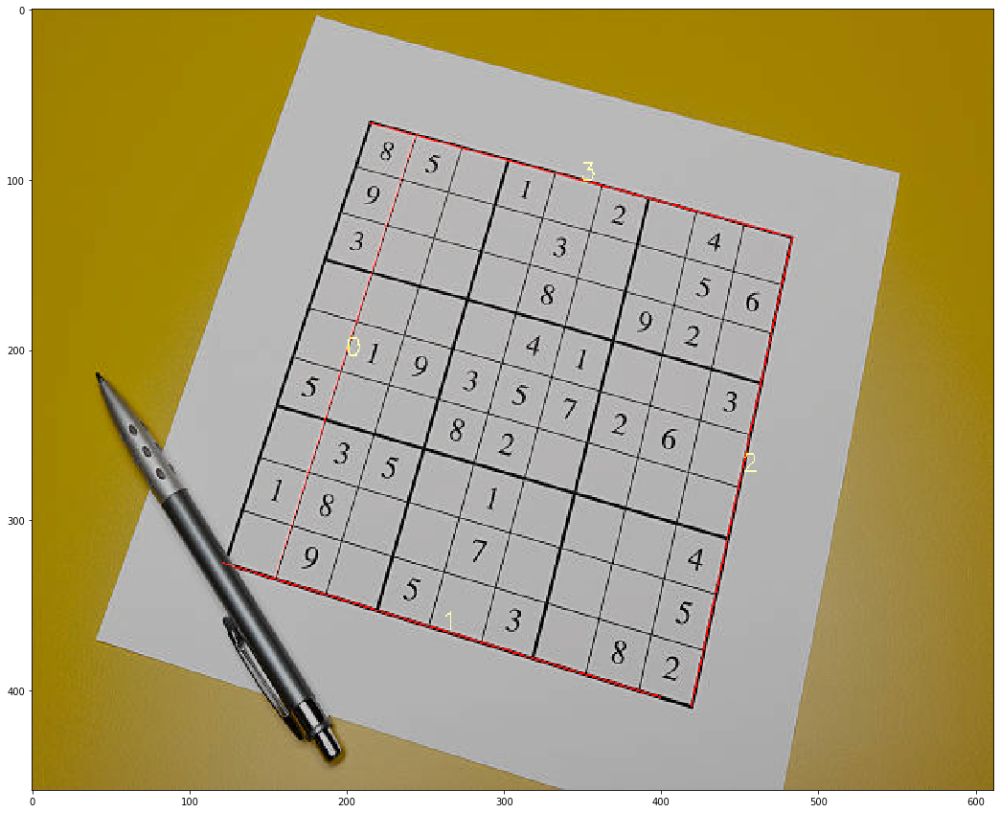

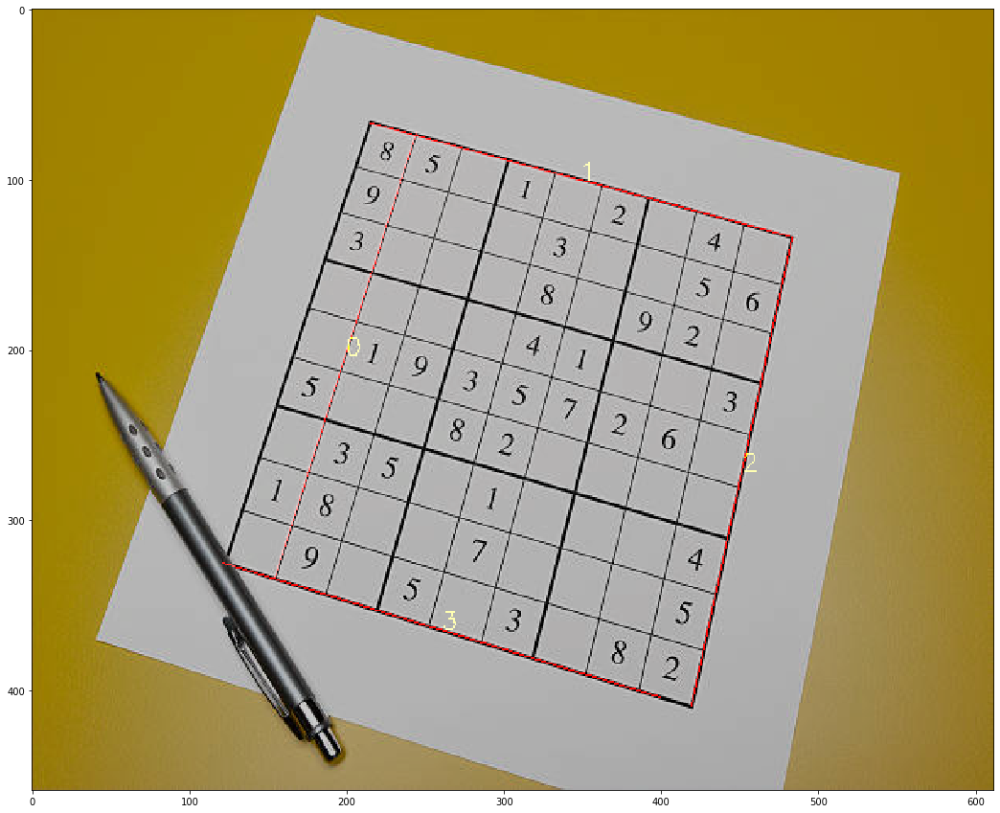

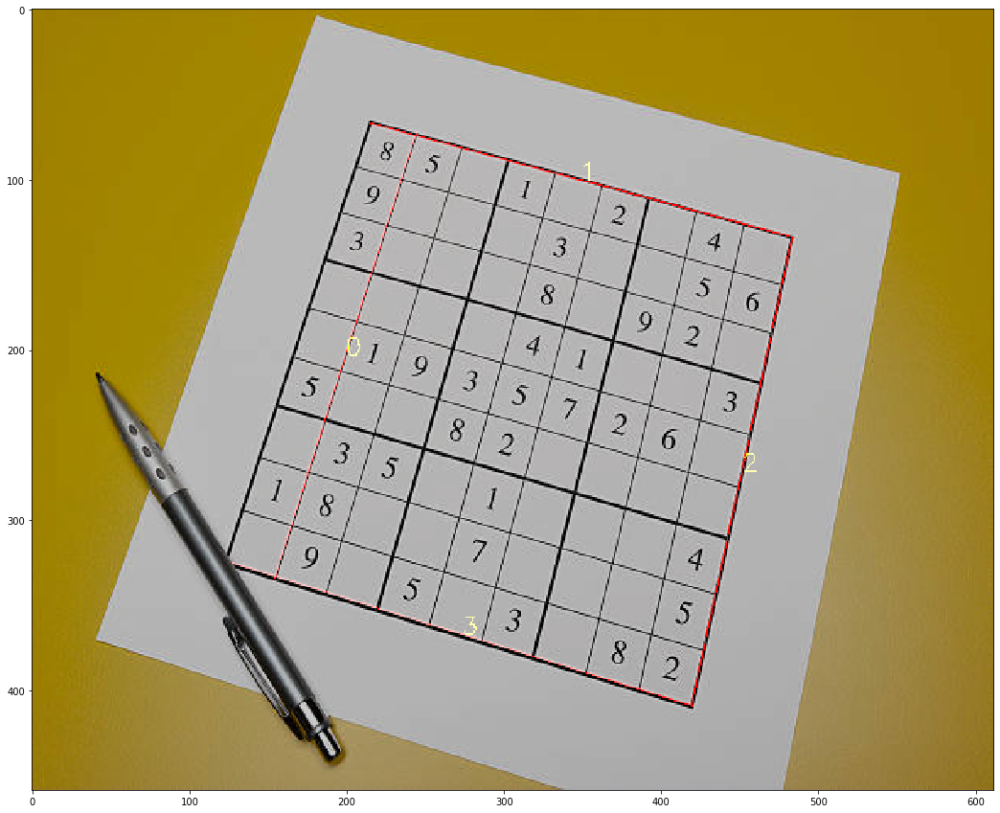

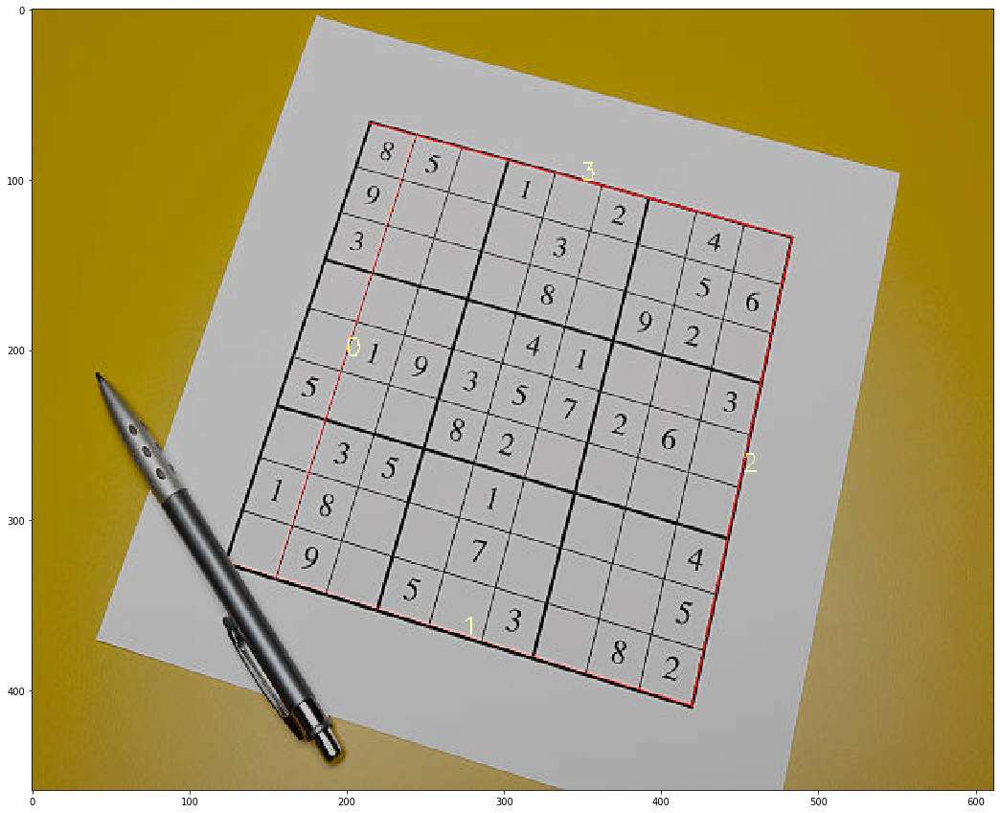

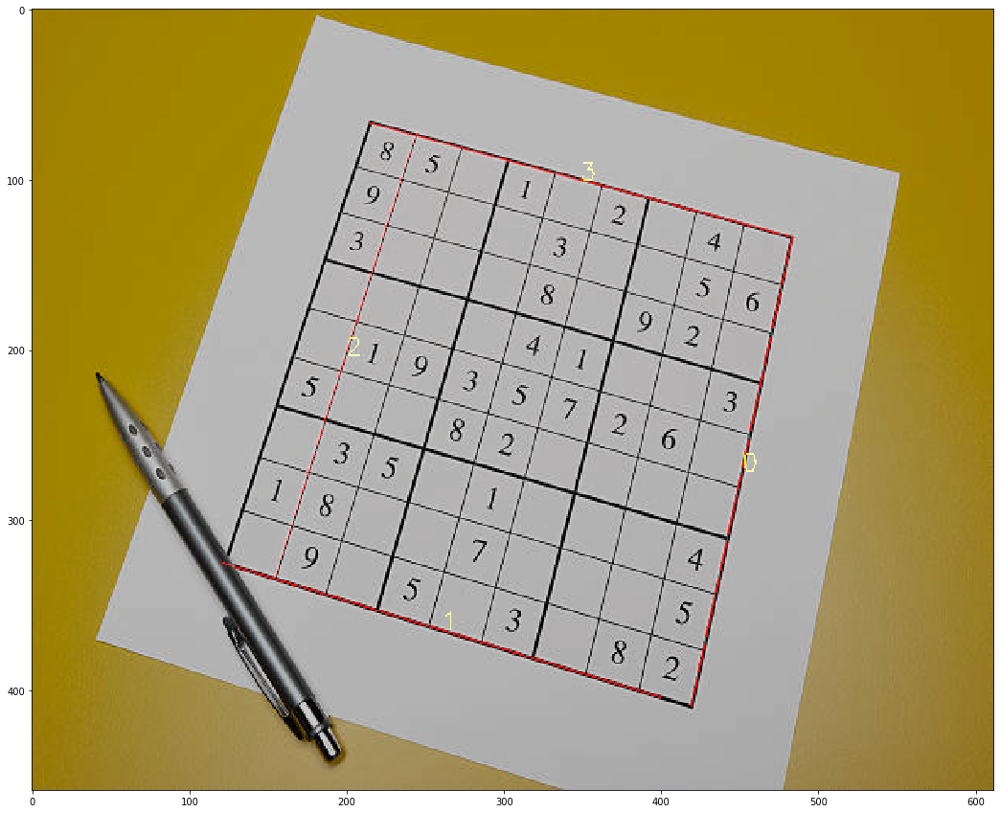

...

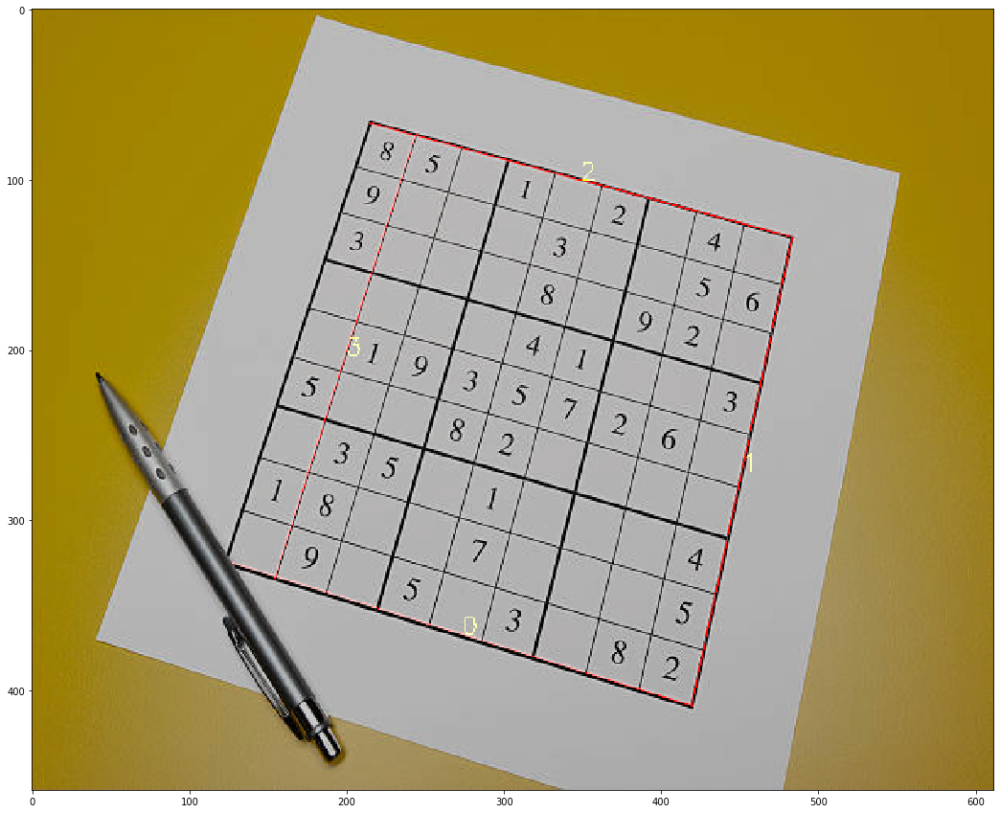

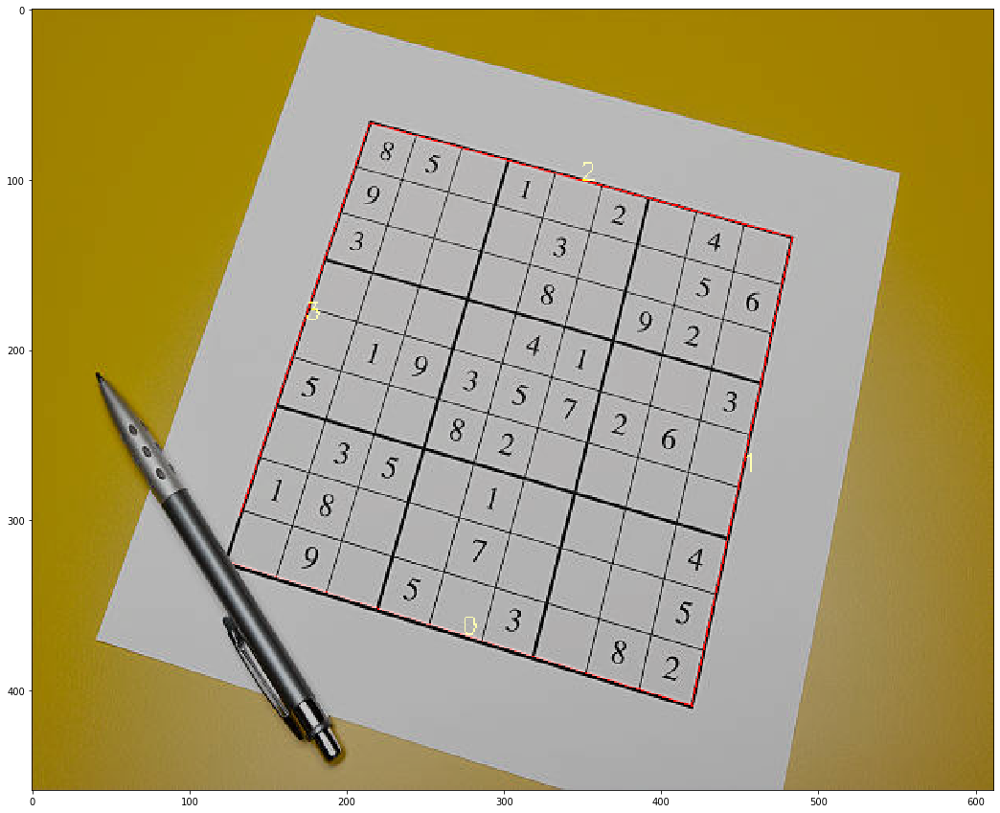

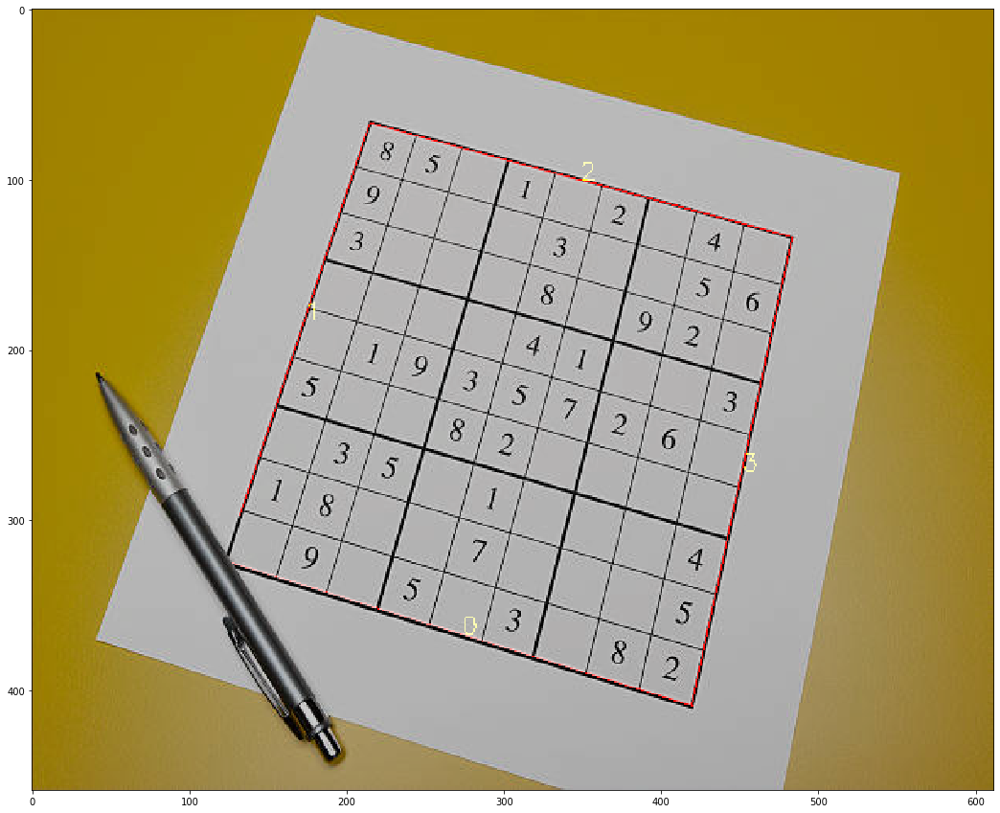

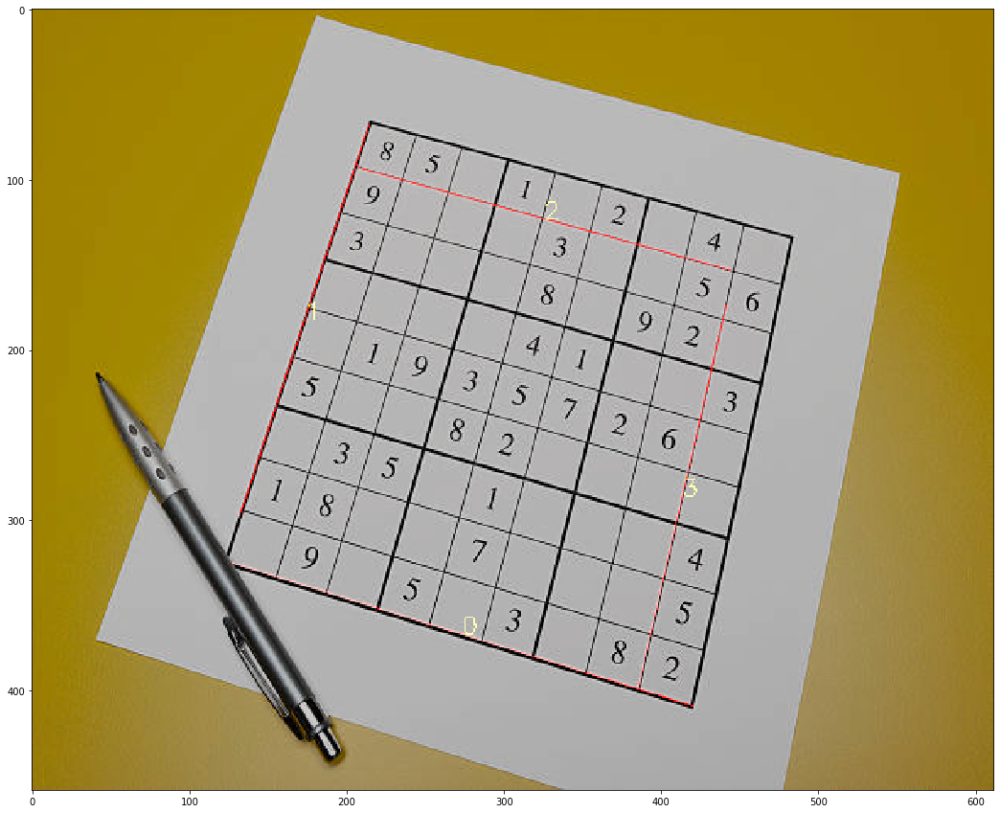

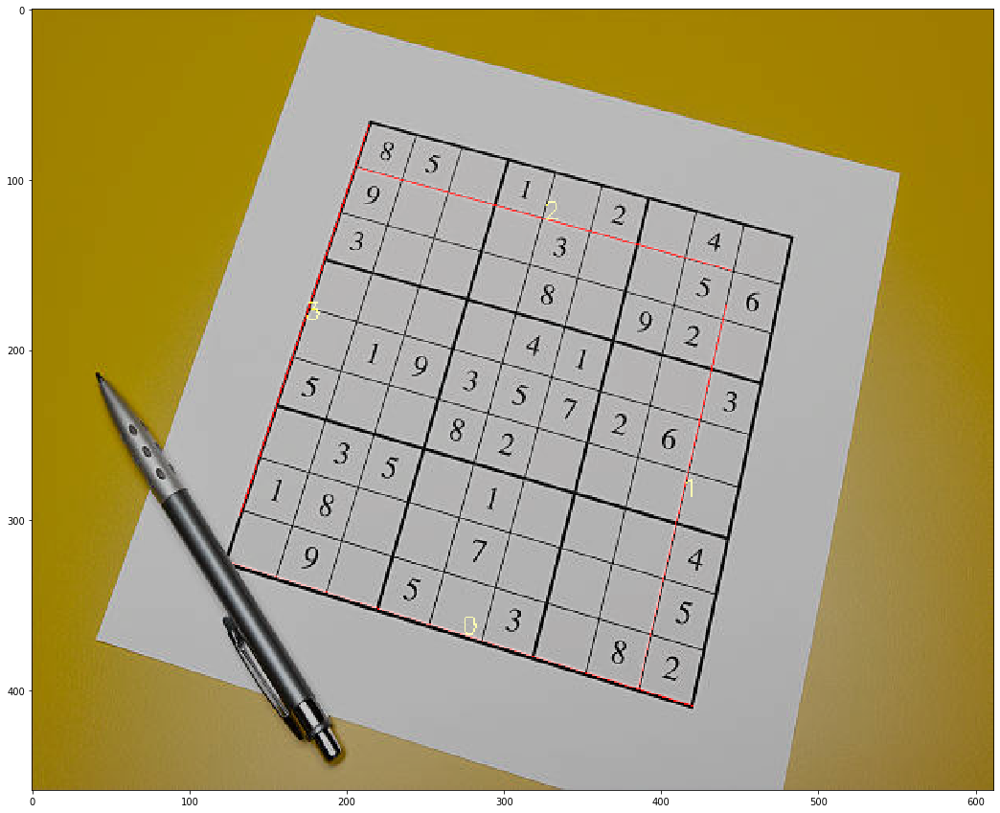

In [124]:
import numpy as np
from tqdm.notebook import tqdm

img = cv2.imread('tests/data/3.jpeg')
def preprcess_pipeline(img):
    gray = cv2.cvtColor(img ,cv2.COLOR_BGR2GRAY)
    kernel_size = 1
    blur_gray = cv2.GaussianBlur(gray,(kernel_size, kernel_size),0)
    

    low_threshold = 300
    high_threshold = 500

    edges = cv2.Canny(blur_gray, low_threshold, high_threshold)

    rho = 1  # distance resolution in pixels of the Hough grid
    theta = np.pi / 180  # angular resolution in radians of the Hough grid
    threshold = 15  # minimum number of votes (intersections in Hough grid cell)
    min_line_length = 50  # minimum number of pixels making up a line
    max_line_gap = 1  # maximum gap in pixels between connectable line segments
    line_image = np.copy(img) * 0  # creating a blank to draw lines on

    threshold=40
    min_line_length=100
    max_line_gap=10

    # Run Hough on edge detected image
    # Output "lines" is an array containing endpoints of detected line segments
    lines = cv2.HoughLinesP(edges, rho, theta, threshold, np.array([]),
                        min_line_length, max_line_gap)
    
    
#     if lines is None:
#         fig, ax = plt.subplots(figsize=(9, 7))
#         ax.imshow(img, interpolation='nearest', aspect='auto')
#         plt.show()
#         return

    lines = [Line(line[0]) for line in lines]
    
    corr_lines = []
    repeats = [False] * len(lines)
    for index1, (line1, repeat) in enumerate(zip(lines, repeats)):
        if repeat:
            continue
        for index2, line2 in enumerate(lines):
            if index2 <= index1:
                continue

            if same_line(line1, line2, verbose=False):
                repeats[index2] = True
                corr_lines.append(average_of_2_lines(line1, line2))
                break
        else:
            corr_lines.append(line1)
    lines = corr_lines

#     loops = []
#     information = [None] * len(lines)
#     for index1, line1 in enumerate(lines):
#         for index2, line2 in enumerate(lines):
#             if index2 != index1 and is_chain([line1, line2]):
# #                 print(index1, index2)
#                 for index3, line3 in enumerate(lines):
#                     if index3 != index1 and index3 != index2 and is_chain([line1, line2, line3]):
# #                         print(index1, index2, index3)
#                         for index4, line4 in enumerate(lines):
#                             if index4 != index1 and index4 != index2 and index4 != index3 and is_loop([line1, line2, line3, line4]):
# #                                 print(index1, index2, index3, index4)
# #                                 print(is_chain([line1, line2, line3, line4]))
#                                 loops.append([line1, line2, line3, line4])
                                
#                                 information[index1] = True
#                                 information[index2] = True
#                                 information[index3] = True
#                                 information[index4] = True
# #         if any(information):
# #             break
#     lines = [line for info, line in zip(information, lines) if info is not None]



#     for index1, line1 in enumerate(lines):
#         for index2, line2 in enumerate(lines):
#             if index2<=index1:
#                 continue
#             print(index1, index2, line1, line2)
#             print(connected(line1, line2, True))

#             print(np.shape(lines))

    font = cv2.FONT_HERSHEY_SIMPLEX
    fontScale = 0.5
    fontColor = (255,255,0)
    lineType = 1
    
    line_image = np.copy(img) * 0
    for index, line in enumerate(lines):
        cv2.line(line_image,(line.start.x, line.start.y), (line.end.x, line.end.y),(255,0,0),1)
        bottomLeftCornerOfText = (int((line.start.x + line.end.x)/2),int((line.start.y + line.end.y)/2))
        cv2.putText(
            line_image,
            str(index), 
            bottomLeftCornerOfText, 
            font, 
            fontScale,
            fontColor,
            lineType
        )


        # Draw the lines on the  image
        lines_edges = cv2.addWeighted(img, 0.8, line_image, 1, 0)


        fig, ax = plt.subplots(figsize=(18, 15))

        ax.imshow(lines_edges, interpolation='nearest', aspect='auto')
        plt.show()
    return lines

    
    
lines = preprcess_pipeline(img)